In [1]:
from starling_rhythm.utils.paths import PROCESSED_DIR, ensure_dir
import pandas as pd
import numpy as np
from scipy.io.wavfile import read, write
from starling_rhythm.utils.audio import extract_amp_env
import matplotlib.pyplot as plt

/mnt/cube/j8xing/conda_envs/txori/starling_rhythm/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
bID = 's_b1555_22'

In [3]:
INTER_PATH = PROCESSED_DIR / bID / 'salv_interpolate'

In [4]:
SAVE_PATH = PROCESSED_DIR / bID / 'salvage_inter_tmf.pickle'

In [5]:
interpolation_stims = pd.read_pickle(SAVE_PATH) ##check

In [6]:
interpolation_stims

,address,test_type,pair_index,interpolation_num,tMF,mean_tMF
0,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,0,"[96.64821062719706, 104.31630660161872, 85.003...",90.494647
1,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,1,"[83.44079288754041, 77.46060862826131, 69.1893...",83.142759
2,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,2,"[89.63808491932394, 91.6583076084646, 92.73147...",95.858954
3,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,3,"[127.36668055115979, 83.41581656314362, 96.118...",93.250860
4,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,4,"[86.66381519570965, 96.56319131154123, 81.1911...",86.461456
...,...,...,...,...,...,...
251,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,1,123,"[12.114678303181751, 14.336671282831864, 11.12...",11.347009
252,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,1,124,"[13.568945972048208, 12.526242932241095, 13.80...",13.625525
253,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,1,125,"[11.248464810525114, 11.218974303154079, 12.09...",11.443044
254,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,1,126,"[7.883693903014045, 7.227004575242476, 4.03061...",7.166905


In [7]:
designation = []
for i, row in interpolation_stims.iterrows():
    if row.interpolation_num < interpolation_stims.interpolation_num.max()/2:
        designation.append('L')
    else:
        designation.append('R')
        
interpolation_stims['designation'] = designation

In [8]:
pair0_stims = interpolation_stims[interpolation_stims.pair_index == 0]
pair1_stims = interpolation_stims[interpolation_stims.pair_index == 1]

In [9]:
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm

<AxesSubplot:xlabel='interpolation_num', ylabel='mean_tMF'>

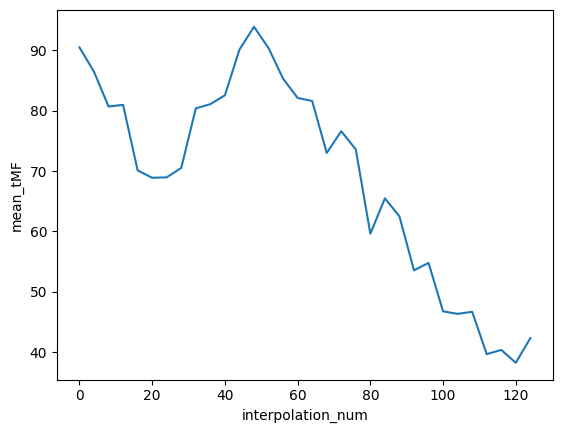

In [10]:
sns.lineplot(data = pair0_stims[::4], x = 'interpolation_num', y = 'mean_tMF')

0it [00:00, ?it/s]/mnt/cube/j8xing/conda_envs/txori/starling_rhythm/lib/python3.10/site-packages/matplotlib/axes/_axes.py:7628: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)
32it [00:02, 13.37it/s]


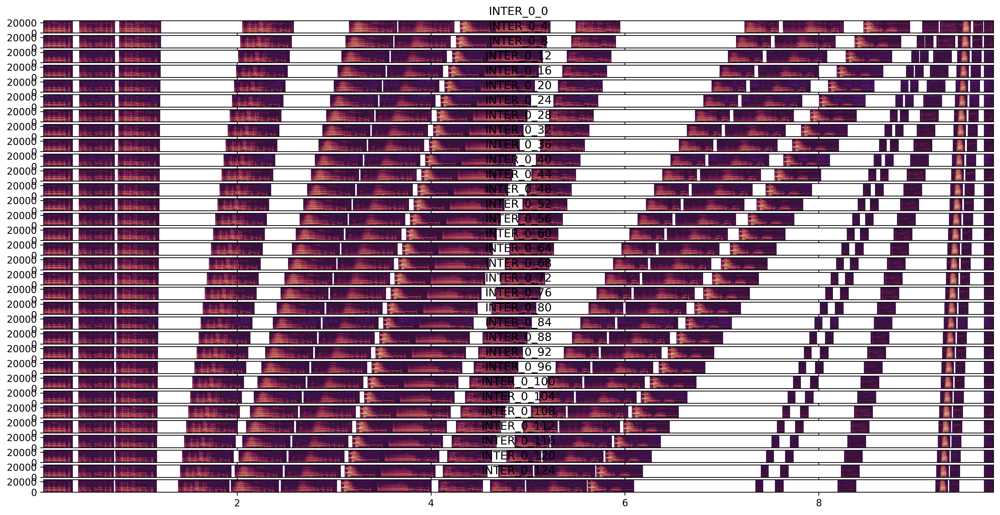

In [11]:
## interpolation only

fig, axs = plt.subplots(len(pair0_stims[::4]), sharex = True, figsize=(18, 9), dpi=300)

for i, row in tqdm(pair0_stims[::4].reset_index().iterrows()):
    axs[i].title.set_text(str(row.test_type) + '_' + str(row.pair_index) + '_' + str(row.interpolation_num))
    sr, data = read(row.address)
    x = axs[i].specgram(data, Fs = sr, cmap = 'twilight')

<AxesSubplot:xlabel='interpolation_num', ylabel='mean_tMF'>

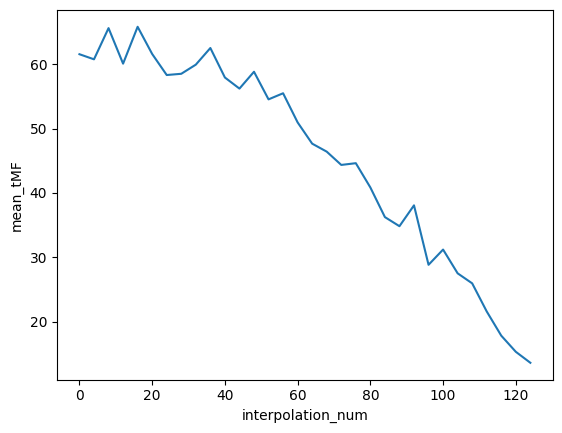

In [12]:
sns.lineplot(data = pair1_stims[::4], x = 'interpolation_num', y = 'mean_tMF')

0it [00:00, ?it/s]/mnt/cube/j8xing/conda_envs/txori/starling_rhythm/lib/python3.10/site-packages/matplotlib/axes/_axes.py:7628: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)
32it [00:02, 13.15it/s]


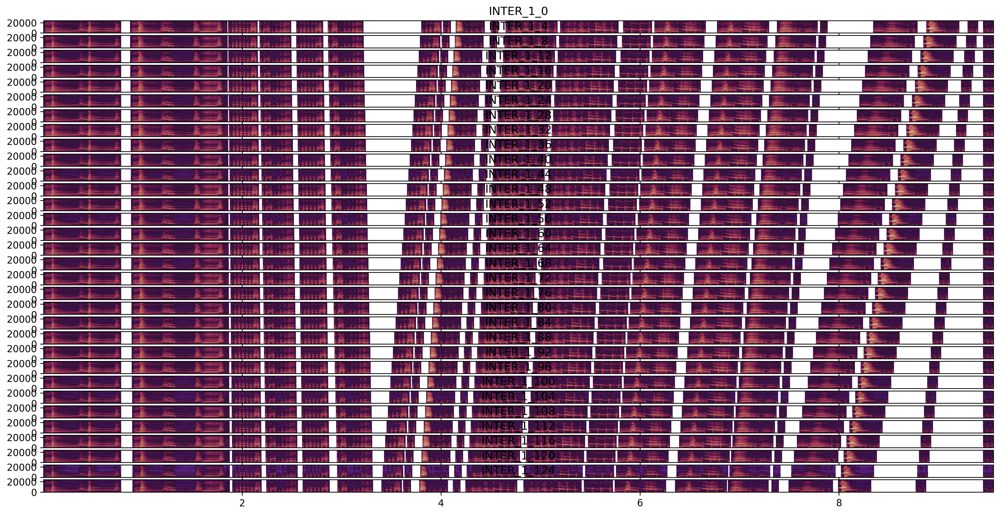

In [13]:
## interpolation only

fig, axs = plt.subplots(len(pair1_stims[::4]), sharex = True, figsize=(18, 9), dpi=300)

for i, row in tqdm(pair1_stims[::4].reset_index().iterrows()):
    axs[i].title.set_text(str(row.test_type) + '_' + str(row.pair_index) + '_' + str(row.interpolation_num))
    sr, data = read(row.address)
    x = axs[i].specgram(data, Fs = sr, cmap = 'twilight')

## Write JSON

In [14]:
json_skeleton = {
    "comments": "json doesn't support comments",
    "experimenter": {
        "name": "Jeffrey Xing",
        "email": "j8xing@ucsd.edu"
    },
    "subject": "B9999",
    "panel_name": "magpi01",
    "experiment_path": "/home/bird/opdat/B9999",
    "stim_path": "/home/bird/opdat/B9999/stimuli",
    "test_stim_path": "/home/bird/opdat/B9999/salv_interpolate",
    "name": "MF/INTER Test",
    "description": "Test if birds are responding to lower or higher level features",
    "debug": True, 
    "log_handlers": [],
    'stims': {},
    "test_conds": {},
    "current_available_motifs": 2,
    "classes": {
        "L": {
            "reward_value": 2.0,
            "punish_value": 10.0,
            "component": "left"
        },
        "R": {
            "reward_value": 2.0,
            "punish_value": 10.0,
            "component": "right"
        }
    },
    "block_design": {
        "blocks": {
            "default": {
                "queue": "block",
                "conditions": []
            }
        },
        "order": ["default"]
    },
    "category_conditions" : [
        {"class": "L", "stim_name": "0"},
        {"class": "R", "stim_name": "1"}
    ],
    "reinforcement": {
        "schedule": "fixed_ratio",
        "ratio": 1,
        "secondary": True,
        "test": "none"
    },
    "correction_trials": True,
    "response_win": 5.0,
    "intertrial_min": 5.0,
    "forced_choice": False,
    "light_schedule": "sun",
    "distribution_type": "amodal",
    "trial_condition": "equal",
    "inject_test": False,
    "sr": 48000,
    "shape": False,
    "force_test_threshold": 10,
    "n_test_motifs": 0,
    "test_rate": 0, 
    "test_order": 'even_tile',
    "tile_size": 4,
    "test_conditions":[],
    "left_stims": {},
    "right_stims": {}
}

## propagate training stimuli

In [15]:
## find where the training stims are at
TRAIN_PATH = PROCESSED_DIR / bID / 'final_stimuli_set.pickle'

In [16]:
stims = pd.read_pickle(TRAIN_PATH)
max_df = stims[stims.type == 'max']
min_df = stims[stims.type == 'min']

In [17]:
left_stims = {}
right_stims = {}

for index, wav in max_df.iterrows():
    left_stims[str(wav['pair_index'])] = str(wav['destinations']).split('/')[-1]
    
for index, wav in min_df.iterrows():
    right_stims[str(wav['pair_index'])] = str(wav['destinations']).split('/')[-1]

In [18]:
json_skeleton['left_stims'] = left_stims
json_skeleton['right_stims'] = right_stims

## propagate test stimuli

In [19]:
interpolation_stims[interpolation_stims.designation == 'R']

,address,test_type,pair_index,interpolation_num,tMF,mean_tMF,designation
64,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,64,"[98.01881532918563, 71.21907997349938, 74.8986...",81.604723,R
65,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,65,"[69.96125962965394, 72.99464304642645, 74.1602...",78.819628,R
66,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,66,"[73.34822929847203, 97.89240036554658, 72.3781...",75.640787,R
67,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,67,"[82.10747195019795, 70.1133268687555, 76.08718...",77.836807,R
68,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,0,68,"[73.9425485306055, 87.62544396945398, 72.31500...",72.997373,R
...,...,...,...,...,...,...,...
251,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,1,123,"[12.114678303181751, 14.336671282831864, 11.12...",11.347009,R
252,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,1,124,"[13.568945972048208, 12.526242932241095, 13.80...",13.625525,R
253,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,1,125,"[11.248464810525114, 11.218974303154079, 12.09...",11.443044,R
254,/mnt/cube/j8xing/starling_rhythm_mfdfa/data/s_...,INTER,1,126,"[7.883693903014045, 7.227004575242476, 4.03061...",7.166905,R


In [20]:
str(interpolation_stims.address[0]).split('/')[-1]

'shuffleGap_INTER_0_0.wav'

In [21]:
test_max_df = interpolation_stims[interpolation_stims.designation == 'L']
test_min_df = interpolation_stims[interpolation_stims.designation == 'R']

In [22]:
test_conditions = []

for i, row in interpolation_stims[::4].iterrows(): #skip every row
    cond = {}
    
    cond['class'] = row.designation
    cond['stim_name'] = str(row.address).split('/')[-1]
    
    test_conditions.append(cond)

In [23]:
test_conditions

[{'class': 'L', 'stim_name': 'shuffleGap_INTER_0_0.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_4.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_8.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_12.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_16.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_20.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_24.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_28.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_32.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_36.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_40.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_44.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_48.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_52.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_56.wav'},
 {'class': 'L', 'stim_name': 'shuffleGap_INTER_0_60.wav'},
 {'class': 'R', 'stim_name': 'shuffleGap_INTER_0_64.wav'},


In [24]:
len(test_conditions)

64

In [25]:
json_skeleton['test_conditions'] = test_conditions

In [26]:
import json

In [27]:
json_output = json.dumps(json_skeleton, indent=4)

with open('TwoAC_INTERMF.json', 'w') as outfile:
    outfile.write(json_output)